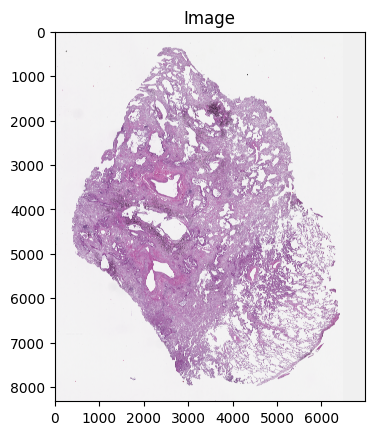

Keys: <KeysViewHDF5 ['coords']>
['coords']
6595
[[ 1488 16832]
 [ 1488 17088]
 [ 1488 17344]
 ...
 [25296 25536]
 [25296 25792]
 [25552 25280]]
0
224
[1. 1.]
[27888 33275]
[27888 33275]


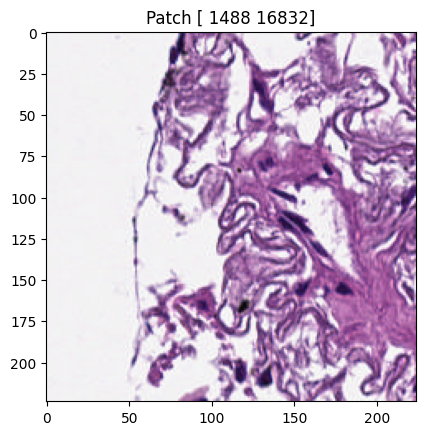

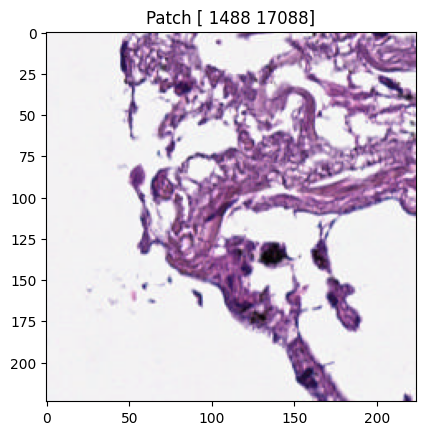

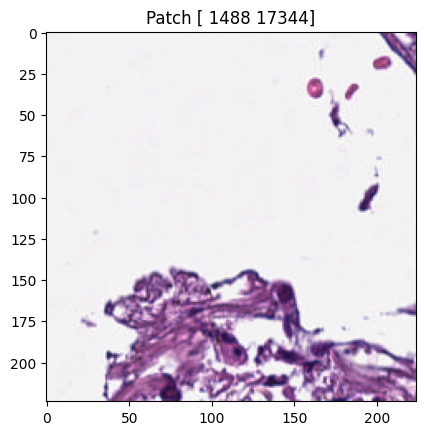

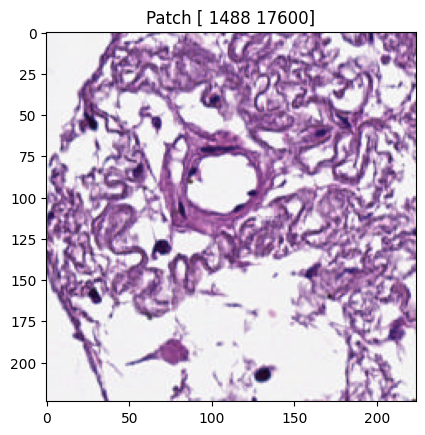

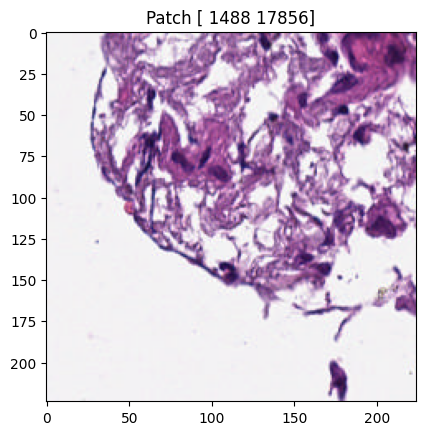

...

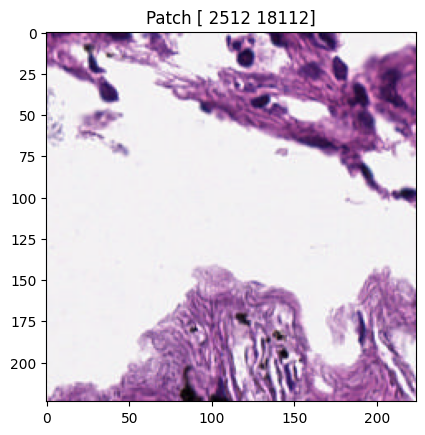

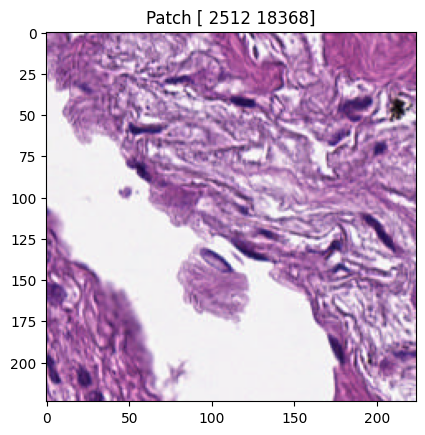

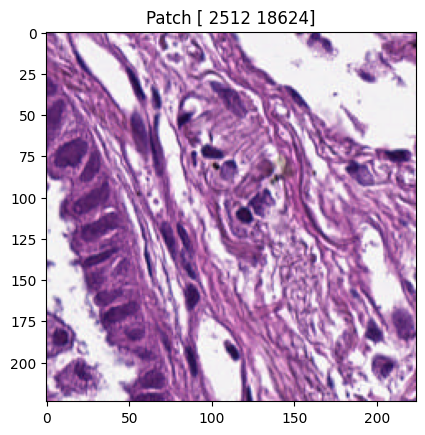

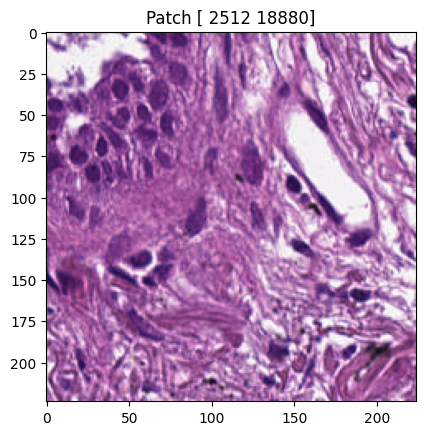

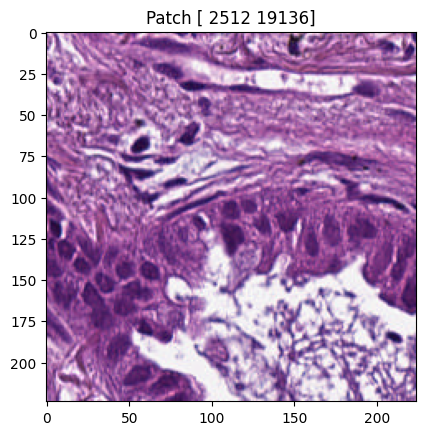

KeyboardInterrupt: 

In [4]:
from pathlib import Path
import h5py
import numpy as np
import openslide
import matplotlib.pyplot as plt

thispath = Path.cwd().resolve()

clamdir = Path(thispath.parent / "data" / "CLAM" / "LungAOEC_List1" / "patches")
datadir = Path("/mnt/nas4/datasets/ToReadme/ExaMode_Dataset1/AOEC")

svs_file = [i for i in datadir.rglob("*.svs") if "LungAOEC" in str(i) and "000029488200270022" in str(i)]

filename = "000029488200270022.h5"

slide = openslide.OpenSlide(str(svs_file[0]))
thumbnail = slide.get_thumbnail(slide.level_dimensions[1])
thumbnail_data = np.array(thumbnail)

plt.imshow(thumbnail_data)
plt.title("Image")
plt.show()

with h5py.File(str(Path(clamdir / filename)), "r") as f:
    # Print all root level object names (aka keys) 
    # these can be group or dataset names 
    print("Keys: %s" % f.keys())
    # get first object name/key; may or may NOT be a group
    group_key = list(f.keys())
    print(group_key)


    # If a_group_key is a group name, 
    # this gets the object names in the group and returns as a list
    coords_obj = f['coords']
    coords_data = coords_obj[()]
    print(len(coords_data))
    print(coords_data)

    patch_level = coords_obj.attrs['patch_level']
    patch_size = coords_obj.attrs['patch_size']
    downsample = coords_obj.attrs['downsample']
    level_dim = coords_obj.attrs['level_dim']
    downsampled_level_dim = coords_obj.attrs['downsampled_level_dim']
    print(patch_level)
    print(patch_size)
    print(downsample)
    print(level_dim)
    print(downsampled_level_dim)

    for coord in coords_data:
        
        patch = slide.read_region(coord, patch_level, [patch_size, patch_size])
        patch_data = np.array(patch)

        plt.imshow(patch_data)
        plt.title(f"Patch {coord}")
        plt.show()